# Auto step size investigation

In [1]:
from logging_ import Logger
import matplotlib.pyplot as plt
from matplotlib.markers import MarkerStyle
import pandas as pd
from settings import OPTIMAL_HYPERS_BEST, OPTIMAL_HYPERS_NORM
from scores import  SCORES


INDEX = 182

ONLY_SAME_APLHA = False


%load_ext autoreload
%autoreload 2

In [2]:
logger = Logger(logs_dir="logs_fmn_projections")

In [3]:
logger.load_all()
# logger.logs_dir="logs_art_add_fmn_to_aa"
# logger.load_all()
# logger.logs_dir="logs_targeted"
# logger.load_all()

In [4]:
sett = {"attack":"fmn2", "fmn_init":True, "balanced_init":False, "targeted_line":False, "top_explore":"10", "ifmn_α_init": "5", "binary_search_steps":"x", "croce_l1":True, "steepest_line":False}

In [5]:
[*logger.where(**sett).keys()]

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1',
 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1',
 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-30',
 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-5',
 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_e

In [6]:
import numpy as np

In [7]:
for norm in SCORES:
    for model in SCORES[norm][0]:
        print(norm, model)
        keys = [*logger.where(**sett, norm=norm, model=model).keys()]
        for i in range(len(keys)):
            print(keys[i])

            print(logger.value_from_id("α_init", keys[i]), logger.value_from_id("ifmn_α_init", keys[i]), logger.dict[keys[i]]["norm_progress"][INDEX, :][logger.dict[keys[i]]["norm_progress"][INDEX, :] != 0].mean(),
                 (logger.dict[keys[i]]["norm_progress"][INDEX, :] == 0)[logger.dict[keys[i]]["acc_progress"][INDEX, :] == 1].sum())
        print()

L1 Maini2020MultipleAVG
dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1
1 5 20.10626 0
dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-30
30 5 20.120893 0
dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-15
15 5 20.105984 0
dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-12
12 5 20.10045 0
dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-Tr

In [8]:
import matplotlib.pyplot as plt

In [9]:
keys = [*logger.where(**sett, norm="L2", model="Rebuffi2021Fixing_70_16_cutmix_extra_l2").keys()]

In [10]:
for i in range(len(keys)):

    print(logger.value_from_id("α_init", keys[i]), logger.dict[keys[i]]["norm_progress"].mean(axis=1)[182])

In [11]:
keys

[]

In [12]:
from utils.metrics import min_norms_pred
# plot the correlation plots:
def extract_corr(keys, logger, norm, model, sett, step_sizes):
    dsts = []
    mns = []
    losses_0= []
    losses_init= []
    g0_sizes = []
    ginit_sizes = []
    norm_progresses = []
    acc_progresses = []
    loss_progresses = []
    classes = []
    print(keys)
    for step_size in step_sizes:
        key = [key for key in keys if logger.value_from_id("α_init", key) == step_size][0]
        distance_to_boundary = logger.dict[key]["norm_progress"][182]
        min_norms_, running_min_preds = min_norms_pred(logger.dict[key]["norm_progress"], logger.dict[key]["acc_progress"], logger.dict[key]["pred_progress"])
        
        
        loss_0 = logger.dict[key]["loss_progress"][0]
        loss_init = logger.dict[key]["loss_progress"][182]
        
        # grad of the class with highest logits
        g0s = logger.dict[key]["x0_grad_size"][0]
        
        # grad of the class with highest logits on the boundary point
        ginits = logger.dict[key]["xinit_grad_size"][0]
        assert len(g0s) == 200
        assert len(ginits) == 200
        
        classes.append(running_min_preds.argmax(axis=1))
        norm_progresses.append(logger.dict[key]["norm_progress"])
        acc_progresses.append(logger.dict[key]["acc_progress"])
        loss_progresses.append(logger.dict[key]["loss_progress"])
        
        g0_sizes.append(g0s)
        ginit_sizes.append(ginits)
        
        losses_0.append(loss_0)
        losses_init.append(loss_init)

        dsts.append(distance_to_boundary)
        mns.append(min_norms_)
    mns = np.stack(mns)
    dsts = np.stack(dsts)
    losses_0 = np.stack(losses_0)
    losses_init = np.stack(losses_init)
    g0_sizes = np.stack(g0_sizes)
    ginit_sizes = np.stack(ginit_sizes)
    norm_progresses = np.stack(norm_progresses)
    acc_progresses = np.stack(acc_progresses)
    loss_progresses = np.stack(loss_progresses)
    classes = np.stack(classes)
    return mns, dsts, losses_0, losses_init, g0_sizes, ginit_sizes, classes, norm_progresses, acc_progresses, loss_progresses

def plot_corr_one(logger, dsts, mns, step_sizes, ax=None):
    for i, s in enumerate(step_sizes):
        ax.scatter(x=dsts[0][np.argmin(mns, axis=0) == i], y=mns[0][np.argmin(mns, axis=0) == i], label=s)
    ax.legend()  
    

def plot_corr_loss(logger, mns, l0, li, step_sizes, ax=None):
    selected = (l0.min(axis=0) > 0.0)
    best = np.argmin(mns, axis=0)
    for i, step_size in enumerate(step_sizes):
        selected_ = (selected & (i==best))
        ax.scatter(x=l0.min(axis=0)[selected_], y=np.ones(selected_.sum())*float(step_size), c="green")
        print(selected_.sum())
    
def plot_corr_lines(logger, dsts, mns, step_sizes, ax=None):
    selected = (mns.std(axis=0) > -0.01)
#     print(len(mns.std(axis=0)))
    best = np.argmin(mns, axis=0)
#     print(best)
#     print(dsts.min(axis=0))
    for i, step_size in enumerate(step_sizes):
        selected_ = (selected & (i==best))
#         print(i==best)
#         print(len(dsts.mean(axis=0)[selected]), len(np.ones_like(selected)*int(step_size)))
#         print(np.ones(selected_.sum())*int(step_size))
        ax.scatter(x=dsts.min(axis=0)[selected_], y=np.ones(selected_.sum())*float(step_size))
        print(selected_.sum())
        
def plot_corr_gsize(logger, mns, gsize, step_sizes, ax=None):
    selected = (mns.std(axis=0) > -0.01)
    best = np.argmin(mns, axis=0)
    for i, step_size in enumerate(step_sizes):
        selected_ = (selected & (i==best))
        ax.scatter(x=gsize.min(axis=0)[selected_], y=np.ones(selected_.sum())*float(step_size))
        print(selected_.sum())

        

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-30', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-15', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-12', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleAVG-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-tra

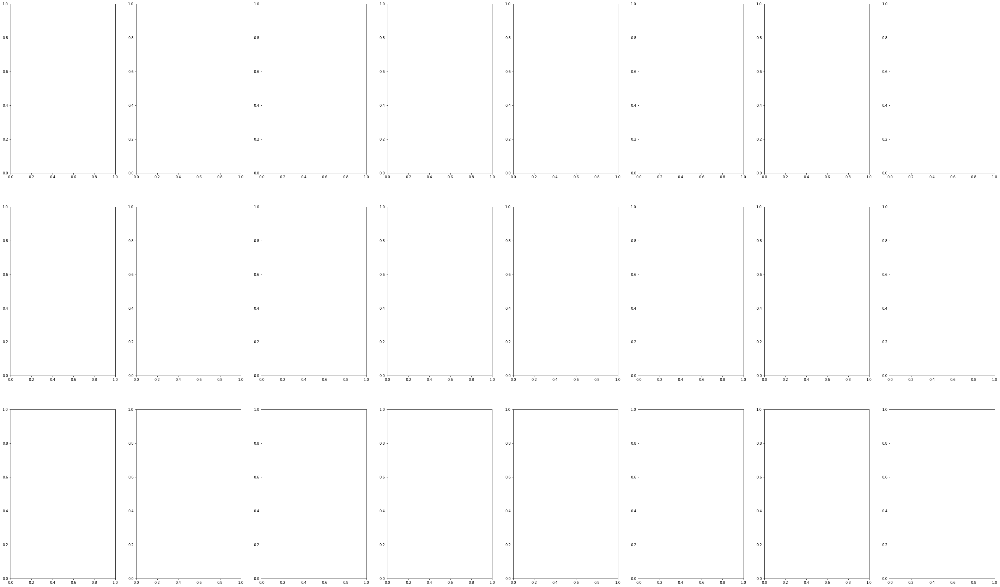

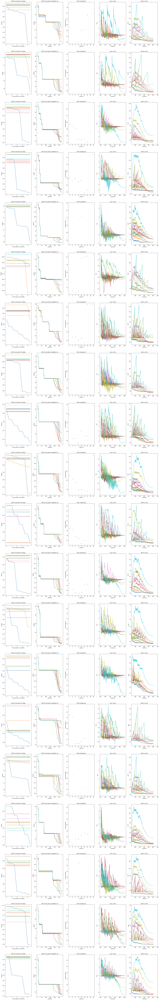

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleMSD-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-10', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleMSD-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleMSD-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-30', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleMSD-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-20', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Maini2020MultipleMSD-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-tra

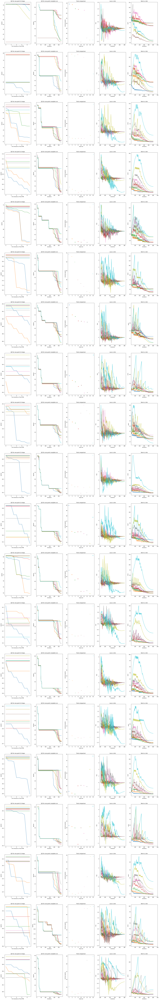

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Augustin2020Adversarial_34_10_extra-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-15', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Augustin2020Adversarial_34_10_extra-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-3', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Augustin2020Adversarial_34_10_extra-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Augustin2020Adversarial_34_10_extra-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-8', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Augustin2020Adversarial_34_10_extra-croce_l1-True-fmn_init-True

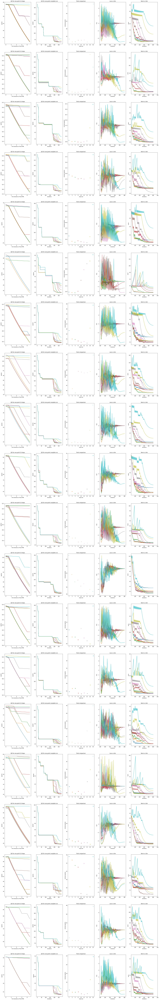

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-1', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-30', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-20', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-8', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_l2-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-step

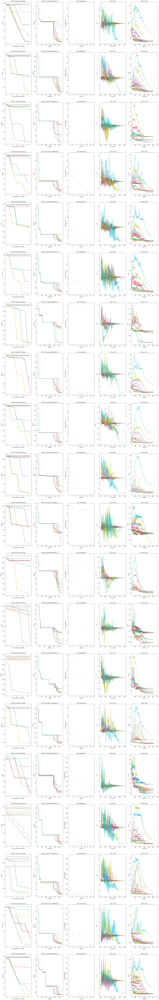

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-5', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-15', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-8', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-3', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Rice2020Overfitting-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad

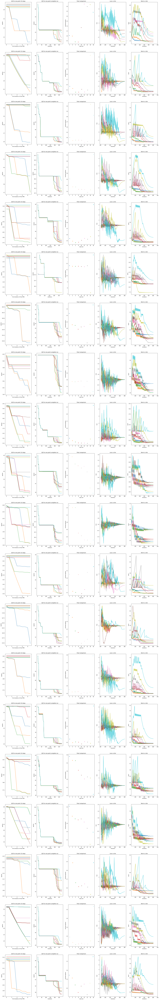

['dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-12', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-5', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-10', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-False-steps-100-top_explore-10-track_grad_size-True-α_final-0.0001-α_init-3', 'dataset-CIFAR10-norm-L1-attack-fmn2-model-Engstrom2019Robustness_linf-croce_l1-True-fmn_init-True-ifmn_α_init-5-loss_f-DL-steepest_line-

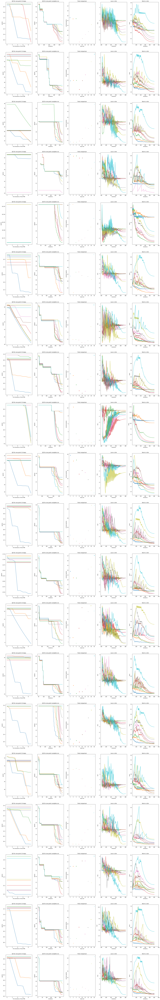

In [21]:
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from utils.metrics import QD
from logging_ import NORM10

from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

#         dic = self.where(**where_settings)
#         comp = list(dic.keys())
# #         print(where_settings)
# #         print(dic)
#         unique_y = list(sorted(set([self.value_from_id(y_axis, c) for c in comp])))
#         unique_x_per_y = [list(sorted(set([self.value_from_id(x_axis, c) for c in filter(lambda x: y in x, dic.keys())]))) for y in unique_y]

fig, axs = plt.subplots(len(SCORES), 8, sharey='none', sharex='none', figsize=(50, 30))
for i, norm in enumerate(SCORES):
    for j, model in enumerate(SCORES[norm][0]):
        if model== "Xiao2020Enhancing":
            continue
#         print(norm, model)
        keys = [*logger.where(**sett, norm=norm, model=model).keys()]
        
        if norm== "L1" and ONLY_SAME_APLHA:
            keys = [key for key in keys if logger.value_from_id("α_init", key) == logger.value_from_id("ifmn_α_init", key)]
        
        if not keys:
            continue
        
        step_sizes = sorted(np.unique([logger.value_from_id("α_init", key) for key in keys]), key=lambda x: float(x))
        mns, dsts,l0, li, g0_size, ginit_size, classes, norm_progresses, acc_progresses, loss_progresses = extract_corr(keys, logger, norm, model, sett, step_sizes)
        
        X = np.stack([dsts.mean(axis=0), l0[0], li.mean(axis=0), g0_size[0], ginit_size[0]]).T
#         X = np.atleast_2d(li.mean(axis=0)).T
        y = mns.argmin(axis=0)
        
        mask = mns.max(axis=0) - mns.min(axis=0) > 0.1#mns.mean(axis=0) * 0.1
        X, y = X[mask], y[mask]
        print(mask.sum(), max(np.unique(y, return_counts=True)[1])/len(y))
#         clf = make_pipeline(StandardScaler(), MinMaxScaler(), LogisticRegression(max_iter=200, penalty="l2", solver="liblinear"))
        clf = make_pipeline(StandardScaler(), MinMaxScaler(), LinearRegression())
        
#         clf = SVC(kernel="linear")
        clf.fit(X[:round(len(X)*0.8)], y[:round(len(X)*0.8)])
#         print(X[:190].shape)
#         print(clf.score(X[round(len(X)*0.8):], y[round(len(X)*0.8):]))
#         print(clf.predict(X[round(len(X)*0.8):]), y[round(len(X)*0.8):])
        print(clf[-1].coef_)
#         print(X, y)

        agg=False
        if agg: 
            plt.figure()
            plt.title(norm+ model)
            for k in mask.nonzero()[0]:
                plt.plot(np.array([float(s) for s in step_sizes]), mns[:,k])
        else:

            normalize = Normalize(0,len(step_sizes)-1)
            scalar_map = ScalarMappable(norm=normalize, cmap="tab10")
            
            idcs = (mns.max(axis=0) - mns.min(axis=0)).argsort()[::-1][0:20]
            fig, axes = plt.subplots(len(idcs),5, figsize=(30,10*len(idcs)))

            for j, k in enumerate(idcs):
                for i, s in enumerate(step_sizes):
    #                 print(axs)
                    qd10 = QD(np.take(norm_progresses[i,:,k], [0]+[*range(1,192)]).reshape(-1,1), np.take(acc_progresses[i,:,k], [0]+[*range(1,192)]).reshape(-1,1))
#                         np.concatenate([[norm_progresses[i,0,k]], norm_progresses[i,182:192,k]]).reshape(1,-1,1), np.concatenate([norm_progresses[i,0,k], norm_progresses[i,182:192,k]]).reshape(1,-1,1))
                    qd = QD(np.take(norm_progresses[i,:,k], [0]+[*range(1,len(norm_progresses[i,:,k]))]).reshape(-1,1), np.take(acc_progresses[i,:,k], [0]+[*range(1,len(norm_progresses[i,:,k]))]).reshape(-1,1))
#                     print(qd10)
            
                # min norms
                    axes[j,2].scatter(s, mns[i,k],  c=i, cmap=scalar_map.cmap, norm=normalize, marker=classes[i,k])
                    axes[j,2].set_ylabel("minimal epsilon")
                    axes[j,2].set_xlabel("step size")
                    axes[j,2].set_title("final comparison")
                # QD 10 steps
                    axes[j,0].plot(qd10[-10:], c=scalar_map.to_rgba(i))
                    axes[j,0].set_ylabel("epsilon")
                    axes[j,0].set_xlabel("first iterations of final FMN")
                    axes[j,0].set_title("QD for one point 10 steps")

                # QD 100 steps
                    axes[j,1].plot(qd,  c=scalar_map.to_rgba(i))
                    axes[j,1].set_ylabel("epsilon")
                    axes[j,1].set_xlabel("iterations")
                    axes[j,1].set_title("QD for one point complete run")
                    
                # Loss vs iter
                    axes[j,3].plot(np.arange(182,282), loss_progresses[i,182:,k],  c=scalar_map.to_rgba(i))
                    axes[j,3].set_ylabel("loss")
                    axes[j,3].set_xlabel("iterations")
                    axes[j,3].set_title("Loss vs iter")
                    
                    
                
                # norm vs iter
                    axes[j,4].plot(np.arange(182,282),norm_progresses[i,182:,k],  c=scalar_map.to_rgba(i))
                    axes[j,4].set_ylabel("norm")
                    axes[j,4].set_xlabel("iterations")
                    axes[j,4].set_title("Norm vs iter")
#                     axes[j,4].set_xlim((182,300))

#                 qd = QD(logger.dict[run_id]["norm_progress"], self.dict[run_id]["acc_progress"])

            plt.show()
                
                
                
#         print(step_sizes)
#         plot_corr_one(logger, mns, dsts, step_sizes, ax=axs[i][j])
#         plot_corr_lines(logger, mns, dsts, step_sizes, ax=axs[i][j])
#         plot_corr_loss(logger, mns, l0, li, step_sizes, ax=axs[i][j])
#         plot_corr_gsize(logger, mns, g0_size, step_sizes, ax=axs[i][j])



## plt.scatter(x=dsts.mean(axis=0), y=np.argmin(mns, axis=0)

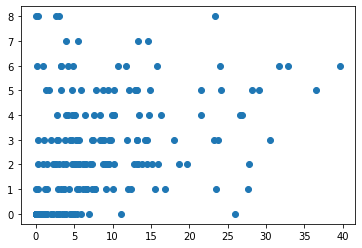

In [14]:
plt.scatter(x=dsts.mean(axis=0), y=np.argmin(mns, axis=0))

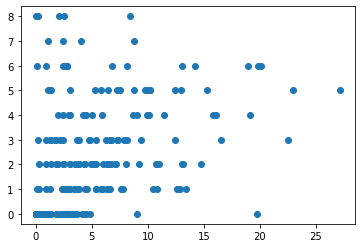

In [15]:
plt.scatter(x=mns.min(axis=0), y=np.argmin(mns, axis=0))

In [16]:
#it seems that the higher the best eps is, the better is to use larger step size

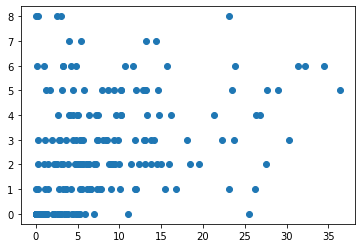

In [17]:
plt.scatter(x=dsts.min(axis=0), y=np.argmin(mns, axis=0))

In [18]:


for x in zip(distance_to_boundary, min_norms_):
    print(x)

NameError: name 'distance_to_boundary' is not defined

In [ ]:
gamma_init = 0.05
gamma_final = 0.001
d = 60
change = (gamma_init - gamma_final)/100
for i in range(100):
    d =d*(1-gamma_init+change*i)
print(d)

In [ ]:
from adv_lib.utils.projections import l1_ball_euclidean_projection
from adv_lib.attacks.auto_pgd import l1_projection
import torch

In [ ]:
normed_grad = torch.tensor([[.8,-.6]])
x0 = torch.zeros_like(normed_grad)
eps = torch.ones(1)*2

In [ ]:
for step_size in [1, 5, 10]:
    delta = (step_size*normed_grad)
#     print(delta.flatten(1))
#     print(delta.norm(p=1, dim=1))
    print(l1_ball_euclidean_projection(delta.flatten(1), eps))
#     print(l1_projection(x0, delta, eps))
#     print(x0, delta)

In [ ]:
print(torch.tensor([.8,-.6]).norm(p=2))
